## Ranking Webpages Within Two-Hop from SAS Homepage Using `PageRank` Algorithm in the `NETWORK` Actionset

------------------------------------------------------------------------------------------------------------------------------

This Jupyter notebook provides an example of building a graph by surfing web pages and shows how to rank them using the `PageRank` algorithm. We demonstrate using the `BeautifulSoup` package to crawl webpages starting from the SAS homepage (https://www.sas.com/en_us/home.html) to obtain all of its two-hops connections. Assuming that each node is a web page and each link is a hyperlink from one page to another, we build a directed unweighted graph. Then, we use the `PageRank` Algorithm of the `centrality` action to find the stationary distribution of a Markov process (i.e., the percentage of time the surfer spends on each page). To read more about the `PageRank` algorithm, refer to [SAS Documentation](https://go.documentation.sas.com/doc/en/pgmsascdc/9.4_3.4/casmlnetwork/casmlnetwork_network_details22.htm#casmlnetwork.network.optgr_centr_prank).  


 
------------------------------------------------------------------------------------------------------------------------------
The flow of this notebook is as follows:
* [Finding all webpages accessible from the SAS homepage in two-hop. ](#first-bullet)
* [Creating nodes and links DataFrames.](#second-bullet)
* [Connecting to a CAS server and uploading our DataFrames.](#third-bullet)
* [Executing `centrality` action to calculate the `PageRank` score and the `degree` of each node.](#fourth-bullet)
* [Visualizing the results.](#fifth-bullet)
------------------------------------------------------------------------------------------------------------------------------
**Prepared by:** Hossein Tohidi (<i class="fa fa-github" aria-hidden="true"></i> [Hossein-Tohidi](https://github.com/Hossein-Tohidi))



In [1]:
import swat
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'
import numpy as np
import re
import copy
import matplotlib.pyplot as plt
%matplotlib notebook 
import sys
import os
sys.path.append(os.path.join(os.path.dirname(os.getcwd()),r"../../common/python"))
import visualization as vz
from bs4 import BeautifulSoup
import requests
from collections import defaultdict
import cas_connection as cas 

 ### Finding all webpages accessible from SAS homepage. <a class="anchor" id="first-bullet"></a>

In [2]:
def web_crawler(url, dict_map, broken_urls=[]):
    links = []          
    try:
        response = requests.get(url)
        soup = BeautifulSoup(response.text, 'html.parser')
        for link in soup.find_all('a', attrs={'href': re.compile('^https://')}):
            new_url = link.get('href')
            if dict_map[new_url]==0:
                dict_map[new_url] = len(dict_map)
            new_link = [dict_map[url], dict_map[new_url]]
            if new_url!= url and new_link not in links:
                links.append(new_link)
    except:
        broken_urls.append(url)
    return links, broken_urls

#### Finding all hyperlinks to SAS home page (first hop) 

The urls are mapped to integer values with the order they are discovered.  

In [3]:
dict_map = defaultdict(int)
broken_urls = set()
url = 'https://www.sas.com/en_us/home.html'
dict_map[url] = 1

links, broken_urls = web_crawler(url,dict_map)
df_links = pd.DataFrame(links, columns = ['from','to'])

df_links

,from,to
0,1,2
1,1,3
2,1,4
3,1,5
4,1,6
...,...,...
310,1,312
311,1,313
312,1,314
313,1,315


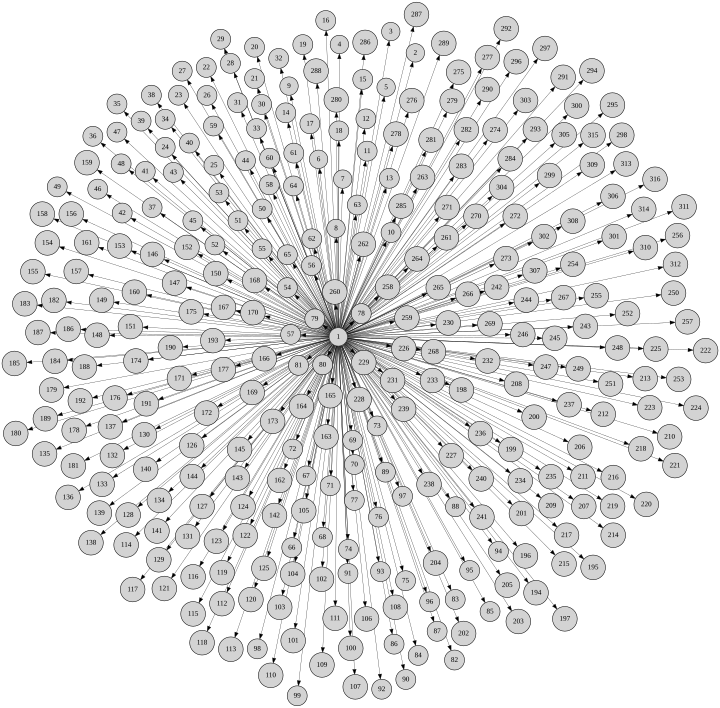

In [4]:
vz.graph2dot(linksDf    = df_links,
             directed   = 'directed',
             stdout     = 0,
             size       = 10,
             nodesAttrs = {"colorscheme":"accent4", "style":"filled"},
             linksAttrs = {'penwidth':'0.5'},
             graphAttrs = {"layout":"sfdp", "overlap":"prism", "overlap_scaling":"-5", 
                           "labelloc":"t", "fontsize":"20","outputorder":"edgesfirst"}
             )

#### Crawling one more hop from obtained urls 

In [5]:
processed_urls = [url]
urls = copy.deepcopy(list(dict_map.keys()))
for url in urls:
    if url not in processed_urls:
        processed_urls.append(url)
        new_links, broken_urls = web_crawler(url,dict_map,broken_urls)
        links.extend(new_links)

### Creating nodes and links DataFrames. <a class="anchor" id="second-bullet"></a>

In [6]:
df_links = pd.DataFrame(links, columns = ['from','to'])
df_nodes = pd.DataFrame(dict_map.items(), columns=['url', 'node'])
df_nodes.head()

,url,node
0,https://www.sas.com/en_us/home.html,1
1,https://www.sas.com/en_us/navigation/header/gl...,2
2,https://www.sas.com/en_us/navigation/header/gl...,3
3,https://www.sas.com/en_us/industry/agriculture...,4
4,https://www.sas.com/en_us/industry/banking.html,5


#### Visualizing the graph

In [7]:
vz.graph2dot(linksDf    = df_links,
             directed   = 'directed',
             stdout     = 0,
             size       = 10,
             nodesAttrs = {'colorscheme':'accent4', 'style':'filled'},
             linksAttrs = {'penwidth':'0.5'},
             graphAttrs = {'layout':'sfdp', 'overlap':'prism', 'overlap_scaling':'-5','outputorder':'edgesfirst'})

### Connecting to CAS server <a class="anchor" id="third-bullet"></a>

In [8]:
s = cas.reconnect(env_path="../../common/conf/environment.txt",)
s.loadActionSet('Network')

NOTE: Added action set 'Network'.


[actionset]

 'Network'

+ Elapsed: 0.00257s, user: 0.001s, sys: 0.002s, mem: 0.268mb

#### Uploading links and nodes DataFrame to CAS

In [9]:
swat.options.cas.print_messages=False 
s.upload(df_links, casout = {'name':'cas_links', 'replace':True})
s.upload(df_nodes, casout = {'name':'cas_nodes', 'replace':True})
swat.options.cas.print_messages=True 

### Executing `Centrality` Action to calculate the `PageRank` score and the `degree` of each node. <a class="anchor" id="fourth-bullet"></a>

In [10]:
result = s.network.centrality(
                direction = 'directed', 
                nodes     = {'name':'cas_nodes'},
                nodesVar  = {'vars':'url'},
                links     = {'name':'cas_links'},
                pageRank  = 'UNWEIGHT',
                degree    = 'UNWEIGHT',
                outNodes  = {'name': 'NodeSetOut', 'replace':True}
                )
df_nodes_scores = s.CASTable('NodeSetOut').to_frame()
df_nodes_scores['node']= df_nodes_scores['node'].astype(int)
df_nodes_scores.head()

NOTE: The number of nodes in the input graph is 13561.
NOTE: The number of links in the input graph is 70980.
NOTE: Processing centrality metrics.
NOTE: Processing centrality metrics used 0.00 (cpu: 0.00) seconds.


,node,url,centr_degree_in,centr_degree_out,centr_degree,centr_pagerank_unwt
0,1,https://www.sas.com/en_us/home.html,204.0,315.0,519.0,0.000170
1,2,https://www.sas.com/en_us/navigation/header/gl...,107.0,284.0,391.0,0.000099
2,3,https://www.sas.com/en_us/navigation/header/gl...,107.0,284.0,391.0,0.000099
3,4,https://www.sas.com/en_us/industry/agriculture...,106.0,327.0,433.0,0.000099
4,5,https://www.sas.com/en_us/industry/banking.html,106.0,336.0,442.0,0.000099


#### Finding the webpage with highest PageRank score

In [11]:
df_nodes_scores.loc[df_nodes_scores['centr_pagerank_unwt'].idxmax()]

node                                                             4603
url                    https://support.sas.com/en/knowledge-base.html
centr_degree_in                                                     8
centr_degree_out                                                    0
centr_degree                                                        8
centr_pagerank_unwt                                       0.000638587
Name: 4613, dtype: object

#### Filtering out nodes with low PageRank score

In [12]:
df_nodes_scores.sort_values(by=['centr_pagerank_unwt'],ascending=False, inplace=True)
df_nodes_filtered = df_nodes_scores.iloc[:100,:]
filtered_nodes = df_nodes_filtered['node'].values

df_links_filtered = df_links[(df_links['from'].isin(filtered_nodes)) & (df_links['to'].isin(filtered_nodes))]
print(f"original graph: number of nodes: {df_nodes.shape[0]}, number of links: {df_links.shape[0]}")
print(f"filtered graph: number of nodes: {df_nodes_filtered.shape[0]}, number of links: {df_links_filtered.shape[0]}")

original graph: number of nodes: 13561, number of links: 70980
filtered graph: number of nodes: 100, number of links: 498


### Visualizing the filtered graph <a class="anchor" id="fifth-bullet"></a>

The darker reds represent the higher PageRank Score.

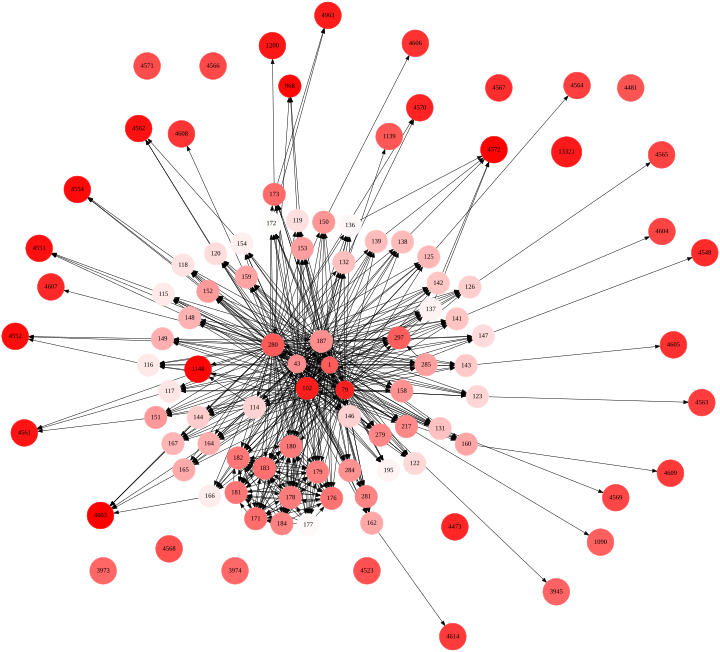

In [13]:
df_nodes_filtered['color'] = [f"1.0000 {1-i/100} 1.0000" for i in range(100)]

vz.graph2dot(linksDf    = df_links_filtered,
             nodesDf    = df_nodes_filtered,
             directed   = 'directed',
             linksFrom  = 'from',
             linksTo    = 'to',
             nodesColor = 'color',
             stdout     = 0,
             size       = 10,
             nodesAttrs = {'colorscheme':'accent4', 'style':'filled'},
             linksAttrs = {'penwidth':'1'},
             graphAttrs = {'layout':'sfdp', 'overlap':'prism', 'overlap_scaling':'-5',
                            'fontsize':'5','outputorder':'edgesfirst'}
             )